# Dynamo without unspliced/spliced matrix

When you don't have unspliced/spliced RNA but still want to utilize the velocity/vector field and downstream differential geometry analysis, we can use `pseudotime_velocity` to convert pseudotime to RNA velocity. Essentially this function computes the gradient of pseudotime and use that to calculate a transition graph (a directed weighted graph) between each cell and use that to learn either the velocity on low dimensional embedding as well as the gene-wise RNA velocity.



In [ ]:
import dynamo as dyn

In [2]:
dyn.configuration.set_figure_params('dynamo', background='white')

## Load data

To demonstrate the appproach in this tutorial, we will use a scRNA-seq dataset of human bone marrow [Setty et al., 2019](https://www.nature.com/articles/s41587-019-0068-4), which can be conveniently acessed through [bone_marrow](https://figshare.com/ndownloader/files/35826944).

In [19]:
#adata=dyn.read('data/setty_bone_marrow.h5ad')
adata=dyn.sample_data.bone_marrow()
adata

AnnData object with n_obs × n_vars = 5780 × 27876
    obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential'
    var: 'palantir'
    uns: 'clusters_colors', 'palantir_branch_probs_cell_types'
    obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs'
    layers: 'spliced', 'unspliced'

Since we use pre-computed dimensionality reduction information, this tutorial is for demonstration purposes only. Therefore, we directly assign `X_tsne` to `X_umap`.

In [20]:
adata.obsm['X_umap']=adata.obsm['X_tsne']

## Preprocess

We use the same data preprocessing method as in the [Zebrafish pigmentation](#) tutorial. Specific parameter definitions can be found in the original tutorial.


In [21]:
preprocessor = dyn.pp.Preprocessor(cell_cycle_score_enable=True)
preprocessor.preprocess_adata(adata, recipe='monocle')

|-----> Running monocle preprocessing pipeline...
|-----------> filtered out 0 outlier cells
|-----------> filtered out 20894 outlier genes
|-----> PCA dimension reduction
|-----> <insert> X_pca to obsm in AnnData Object.
|-----> computing cell phase...
|-----> [Cell Phase Estimation] completed [74.2473s]
|-----> [Cell Cycle Scores Estimation] completed [0.5963s]
|-----> [Preprocessor-monocle] completed [15.8703s]


|-----> retrieve data for non-linear dimension reduction...
|-----? adata already have basis umap. dimension reduction umap will be skipped! 
set enforce=True to re-performing dimension reduction.
|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:pca
|-----> method arg is None, choosing methods automatically...
|-----------> method pynn selected
|-----> [UMAP] completed [8.6142s]
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


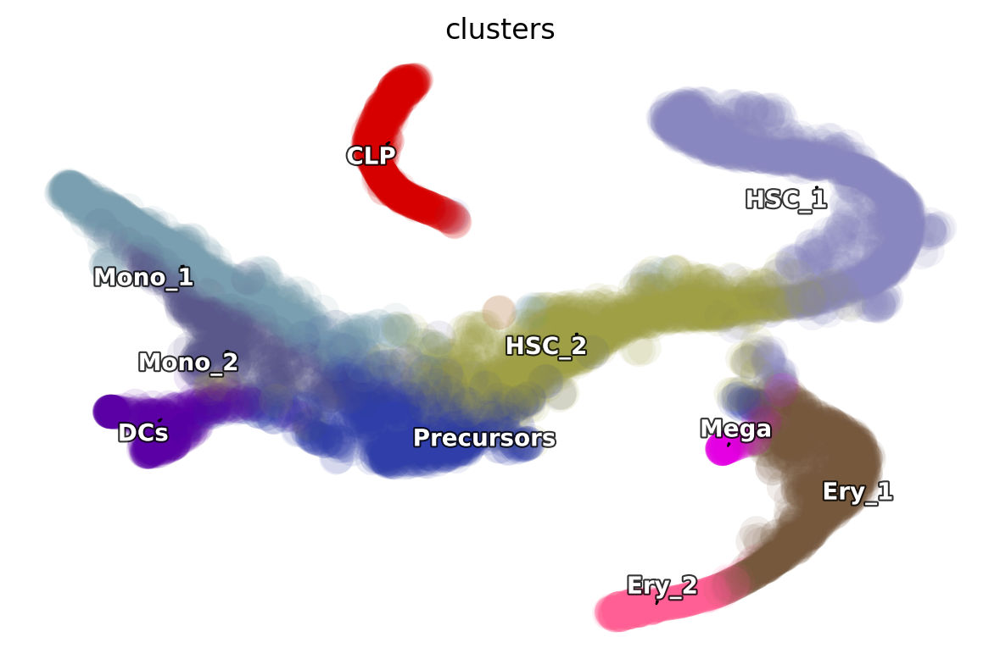

In [22]:
dyn.tl.reduceDimension(adata)

dyn.pl.umap(adata, color='clusters',
           save_show_or_return='show',
            adjust_legend=True)

We use the expression matrix X to replace the splicing matrix M_s.

In [23]:
adata.layers['M_s']=adata.X

## Convert pseudotime to RNA velocity

Essentially this function computes the gradient of pseudotime and use that to calculate a transition graph (a directed weighted graph) between each cell and use that to learn either the velocity on low dimensional embedding as well as the gene-wise RNA velocity.

In [25]:
dyn.tl.pseudotime_velocity(adata,
                          pseudotime='palantir_pseudotime')

|-----> Embrace RNA velocity and velocity vector field analysis for pseudotime...
|-----> Retrieve neighbor graph and pseudotime...
|-----> Computing transition graph via calculating pseudotime gradient with hodge method...
|-----> Use pseudotime transition matrix to learn low dimensional velocity projection.
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [0.9457s]
|-----> Use pseudotime transition matrix to learn gene-wise velocity vectors.
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [29.6961s]


## Visualization

All visualization functions and tutorials are consistent with the Zebrafish pigmentation tutorial.

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


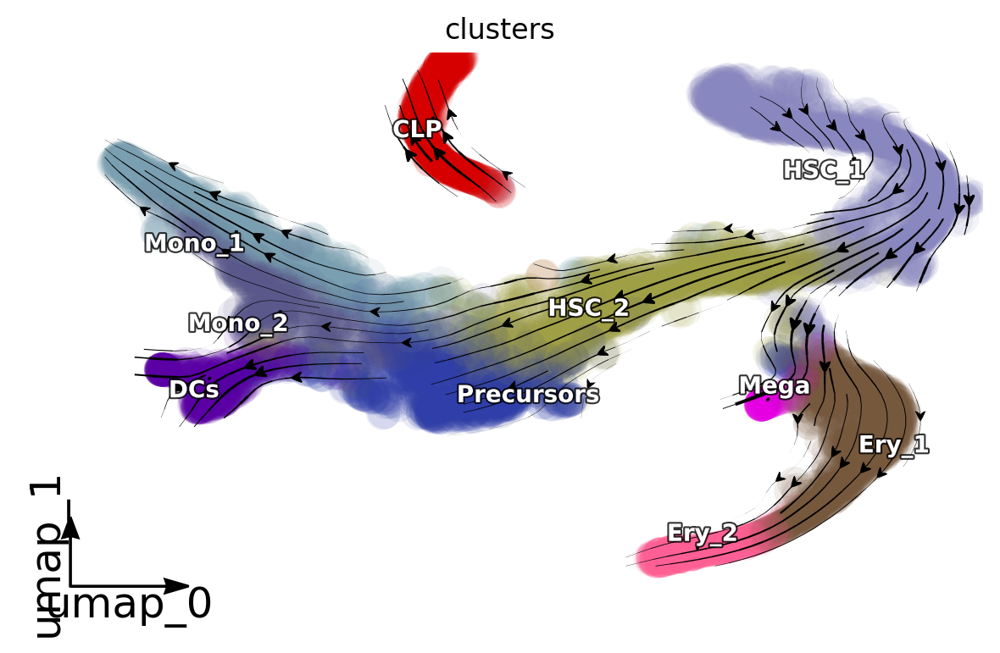

In [28]:
dyn.pl.streamline_plot(adata, color=['clusters'], 
                       basis='umap', show_legend='on data', 
                       s_kwargs_dict={'adjust_legend':True},
                       show_arrowed_spines=True)

|-----> X shape: (5780, 2) V shape: (5780, 2)
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


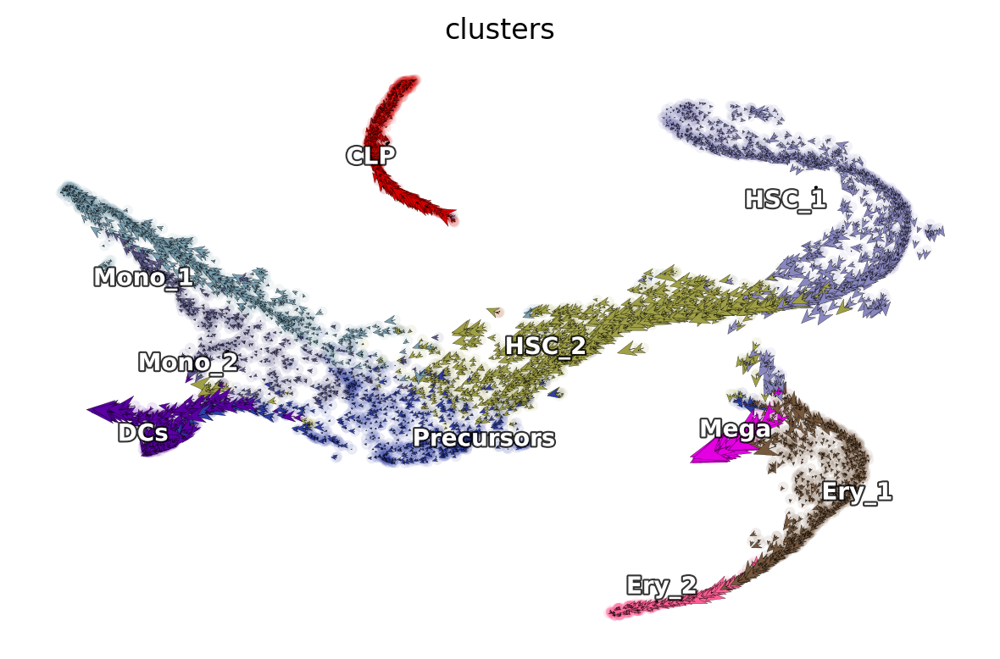

In [29]:
dyn.pl.cell_wise_vectors(adata, color=['clusters'], basis='umap', 
                         show_legend='on data', quiver_length=6, 
                         quiver_size=6, pointsize=0.1, 
                         s_kwargs_dict={'adjust_legend':True},
                         show_arrowed_spines=False)

In [30]:
# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction
dyn.vf.VectorField(adata, basis='umap', M=1000, pot_curl_div=True) 

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [5.2729s]
|-----> Running ddhodge to estimate vector field based pseudotime in umap basis...
|-----> graphizing vectorfield...
|-----------> calculating neighbor indices...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> not all cells are used, set diag to 1...
|-----------> Constructing W matrix according upsampling=True and downsampling=True options...
|-----> [ddhodge completed] completed [30.7381s]
|-----> Computing curl..

Calculating 2-D curl: 100%|██████████| 5780/5780 [00:00<00:00, 16989.25it/s]

|-----> Computing divergence...



Calculating divergence: 100%|██████████| 6/6 [00:00<00:00, 19.69it/s]


|-----> [VectorField] completed [36.9559s]


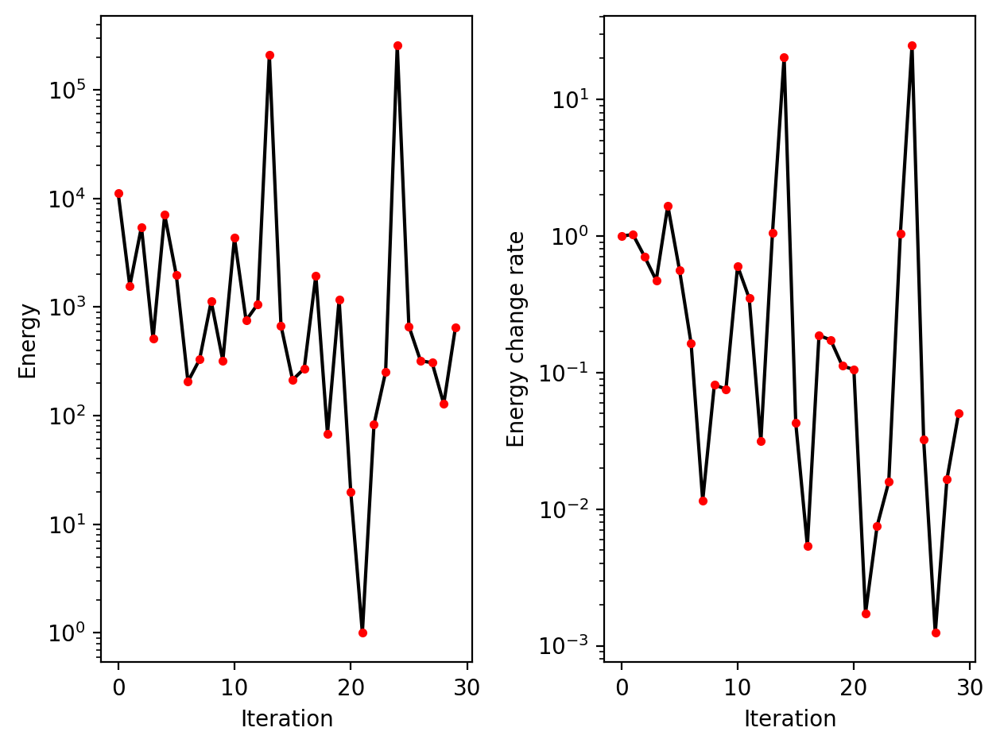

In [31]:
dyn.pl.plot_energy(adata, basis='umap') 

|-----> Vector field for umap is but its topography is not mapped. Mapping topography now ...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_umap
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


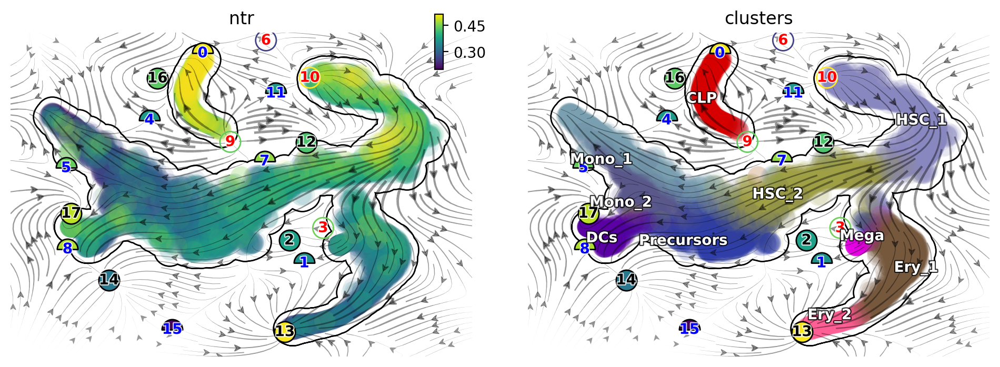

In [32]:
dyn.pl.topography(adata, basis='umap', background='white', 
                  color=['ntr', 'clusters'], 
                  streamline_color='black', s_kwargs_dict={'adjust_legend':True},
                  show_legend='on data', frontier=True)

|-----------> plotting with basis key=X_umap


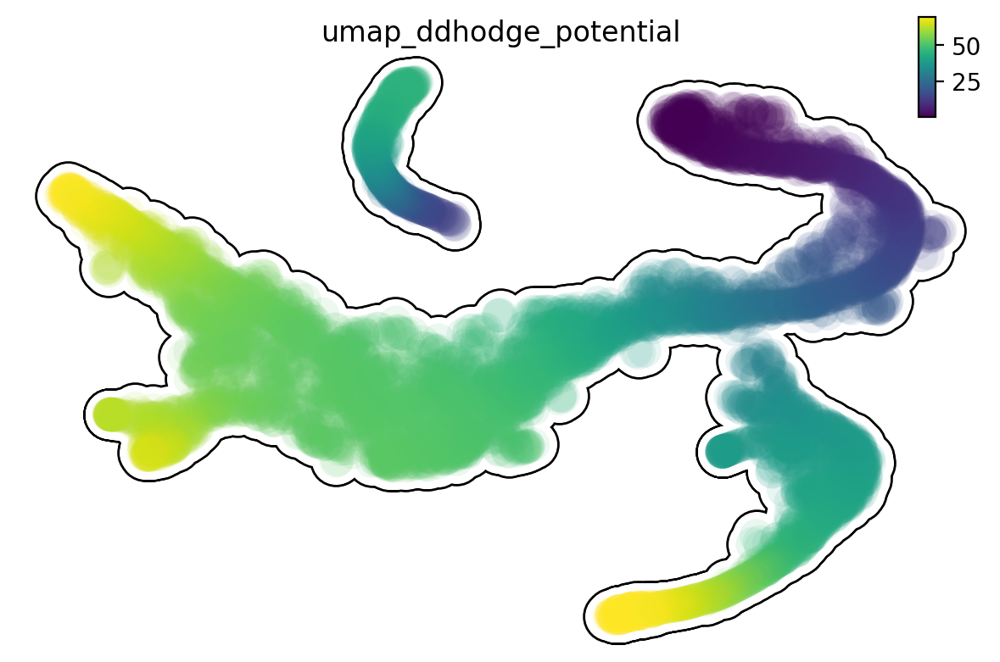

In [33]:
dyn.pl.umap(adata,  color='umap_ddhodge_potential', frontier=True)

In [34]:
progenitor = adata.obs_names[adata.obs.clusters.isin(['HSC_1'])]
len(progenitor)

1118

In [35]:
dyn.pd.fate(adata, basis='umap', init_cells=progenitor, 
            interpolation_num=100,  direction='forward',
           inverse_transform=False, average=False, cores=10)

AnnData object with n_obs × n_vars = 5780 × 27876
    obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_sampled', 'umap_ddhodge_div', 'umap_potential', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap'
    var: 'palantir', 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'frac', 'use_for_pca', 'ntr'
    uns: 'clusters_colors', 'palantir_branch_probs_cell_types', 'pp', 'velocyto_SVR', 'feature_selection', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'cell_phase_order', 'cell_phase_genes', 'neighbors', 'VecFld_umap', 'fate_umap'
    obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'X_umap', 'X_pca', 'cell_cycle_scores', 'velocity_uma

In [37]:
%%capture
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', 
                       ax=ax, save_show_or_return='return')

|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


In [38]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=adata, color='clusters', ax=ax)

|-----? the number of cell states with fate prediction is more than 50. You may want to lower the max number of cell states to draw via cell_states argument.
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


In [39]:
%matplotlib notebook
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**64 # Ensure all frames will be embedded. 

from matplotlib import animation
import numpy as np 

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                               frames=np.arange(100), interval=100, blit=True)
plt.show()

In [40]:
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.